In [1]:
using LinearAlgebra, Plots, BenchmarkTools

### MATH50003 Lecture Notes

### Condition numbers

**Theorem (matrix-vector backward error)**
For $A ∈ ℝ^{m × n}$ and $𝐱 ∈ ℝ^n$ we have
$$
{\rm mul}(A, 𝐱) = (A + δA) 𝐱
$$
where
$$
|δA| ≤ {n ϵ_{\rm m} \over 2-nϵ_{\rm m}}  |A|.
$$
Therefore
$$
\begin{align*}
\|δA\|_1 &≤  {n ϵ_{\rm m} \over 2-nϵ_{\rm m}} \|A \|_1 \\
\|δA\|_2 &≤  {\sqrt{\min(m,n)} n ϵ_{\rm m} \over 2-nϵ_{\rm m}} \|A \|_2 \\
\|δA\|_∞ &≤  {n ϵ_{\rm m} \over 2-nϵ_{\rm m}} \|A \|_∞
\end{align*}
$$


**Definition (condition number)**
For a square matrix $A$, the _condition number_ (in $p$-norm) is
$$
κ_p(A) := \| A \|_p \| A^{-1} \|_p
$$
with the $2$-norm:
$$
κ_2(A) = {σ_1 \over σ_n}.
$$


**Theorem (relative-error for matrix-vector)**
The _worst-case_ relative error in $A 𝐱 ≈ (A + δA) 𝐱$ is
$$
{\| δA 𝐱 \| \over \| A 𝐱 \| } ≤ κ(A) ε
$$
if we have the relative pertubation error $\|δA\| = \|A \| ε$.

Thus for floating point arithmetic we know the error is bounded by $κ(A) {n ϵ_{\rm m} \over 2-nϵ_{\rm m}}$.


### Question
$$
\begin{bmatrix}
1/3 & 1/5 \\ 0 & 1/10^3
\end{bmatrix},
 \begin{bmatrix} 1 \\ & 1/2 \\ && ⋯ \\ &&& 1/2^{10} \end{bmatrix}
$$
Compute the relative error in computing $A 𝐯$ (using `big` for a high-precision version to compare against)
where $𝐯$ is the last column of $V$ in the SVD $A = U Σ V^⊤$, computed using the `svd` command with
`Float64` inputs.

In [2]:
# The first matrix
A = [1/3 1/5; 0 1/1000]
K = svd(A)
cond_number = K.S[1] / K.S[end]
v = K.Vt[:,end]

A_big = [big(1/3) big(1/5); 0 big(1/1000)]

norm(A_big*v - A*v, 2) / norm(A_big*v, 2)

8.997296361317471232769659734743566495672667762771161645237016068601546178324193e-20

In [3]:
# The second matrix
B = diagm(2.0 .^ (0:-1:-10)) # diagm does similar job as Diagonal, yet Diagonal will not store off-diagonal values while diagm will fill them with zeros
K = svd(B)
cond_number = K.S[1] / K.S[end]
v = K.Vt[:,end]

B*v

11-element Vector{Float64}:
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0009765625

### Indefinite Integration

Our approach to solving $u(a)=c, u'=f(x)$ is :

1). Approximate the solution on [a,b] evaluated on a -point grid $x_1, ..., x_n$ with step size $h = \frac{b-a}{n-1}$.

2). Replace the derivatives with finite-difference approximations (forward, central or backward difference)

3). Recast the differential equation as a linear system whose solution is $u$. Add the initial/boundary conditions to make sure the system is square.
$$
\begin{bmatrix}
𝐞_1^⊤ \\
D_h
\end{bmatrix} 𝐮^{\rm f} = \underbrace{ \begin{bmatrix}
1 \\
-1/h & 1/h\\
& \ddots & \ddots \\
&& -1/h & 1/h
\end{bmatrix}}_{L_h} 𝐮^{\rm f} = \begin{bmatrix} c \\ 𝐟^{\rm f} \end{bmatrix}
$$

### Example

Solve the integration $$u(x)=\int _0^x \cos t dt, u(0)=0$$

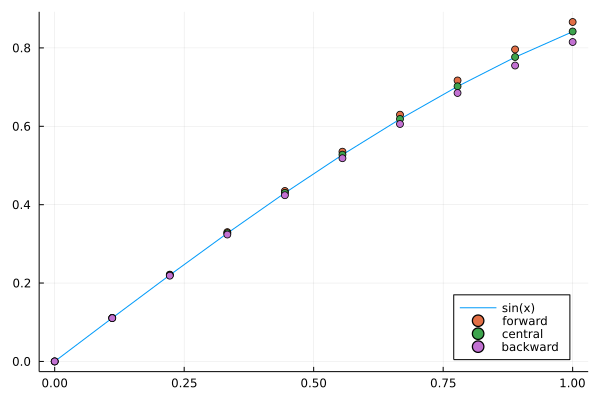

In [6]:
function indefint(x)
    h = step(x) # x[k+1] - x[k]
    n = length(x)
    d = [1; fill(1/h, n-1)] # Diagonal entries
    l = fill(-1/h, n-1) # Sub diagonal entries
    L = Bidiagonal(d, l, :L)
end

n = 10
x = range(0,1; length=n)
L = indefint(x)

c = 0
f = x -> cos(x)

m = (x[1:end-1] + x[2:end]) / 2

# forward difference
𝐟ᶠ = f.(x[1:end-1]) # We have to stop at x_(n-1) to prevent getting out of our grid，

# central difference
𝐟ᵐ = f.(m) # central difference

# backward difference
𝐟ᵇ = f.(x[2:end])

# solve
𝐮ᶠ = L \ [c; 𝐟ᶠ] # Add initial condition to make a square matrix 
𝐮ᵐ = L \ [c; 𝐟ᵐ]
𝐮ᵇ = L \ [c; 𝐟ᵇ]

plot(x, sin.(x); label="sin(x)", legend=:bottomright)
scatter!(x, 𝐮ᶠ; label="forward")
scatter!(x,  𝐮ᵐ; label="central")
scatter!(x,  𝐮ᵇ; label="backward")

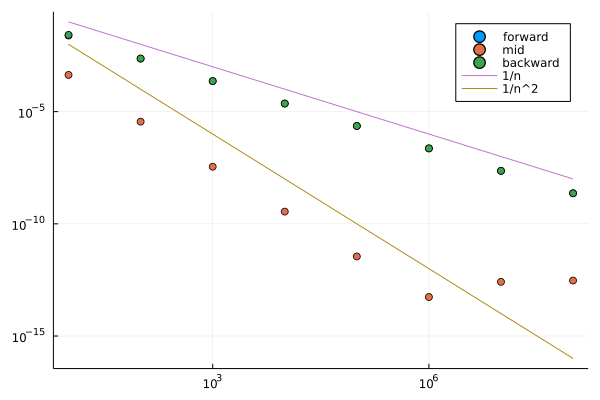

In [17]:
function indefint(x)
    h = step(x) # x[k+1] - x[k]
    n = length(x)
    d = [1; fill(1/h, n-1)] # Diagonal entries
    l = fill(-1/h, n-1) # Sub diagonal entries
    L = Bidiagonal(d, l, :L)
end

function forward_err(u, c, f, n)
    x = range(0,1; length = n)
    𝐮ᶠ = indefint(x) \ [c; f.(x[1:end-1])]
    norm(𝐮ᶠ - u.(x), Inf)
end

function mid_err(u, c, f, n)
    x = range(0,1; length = n)
    m = (x[1:end-1] + x[2:end]) / 2
    𝐮ᵐ = indefint(x) \ [c; f.(m)]
    norm(𝐮ᵐ - u.(x), Inf)
end

function backward_err(u, c, f, n)
    x = range(0,1; length = n)
    h = step(x)
    A = Bidiagonal([1; fill(1/h, n-1)], fill(-1/h, n-1), :L)
    𝐮ᵇ = A \ [c; f.(x[2:end])]
    norm(𝐮ᵇ - u.(x), Inf)
end

scatter(ns, forward_err.(sin, 0, f, ns); xscale=:log10, yscale=:log10, label="forward")
scatter!(ns, mid_err.(sin, 0, f, ns); label="mid")
scatter!(ns, backward_err.(sin, 0, f, ns); xscale=:log10, yscale=:log10, label="backward")
plot!(ns, ns .^ (-1); label="1/n")
plot!(ns, ns .^ (-2); label="1/n^2")

Implement indefinite-integration 
where we take the average of the two grid points:
$$
{u'(x_{k+1}) + u'(x_k) \over 2} ≈ {u_{k+1} - u_k \over h}
$$
What is the observed rate-of-convergence using the ∞-norm for $f(x) = \cos x$
on the interval $[0,1]$?

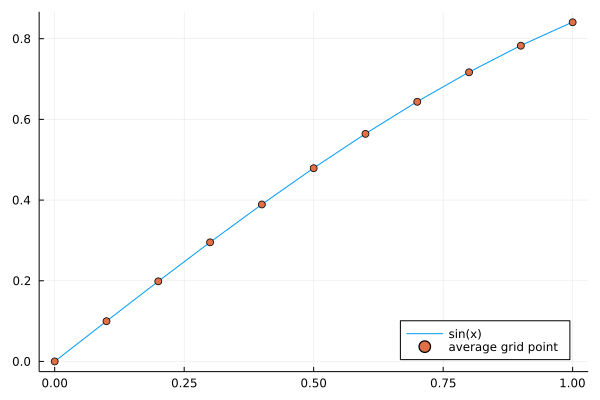

In [57]:
n = 10
x = range(0, 1; length=n)
h = step(x)
d = [1; fill(1/h, n-1)] # Diagonal entries
l = fill(-1/h, n-1) # Sub diagonal entries
L = Bidiagonal(d, l, :L)

c = 0 # u(0) = 0
f = x -> cos(x)

𝐟 = f.(x) # evaluate f at all but last points
uₙ = L \ [c; (𝐟[1:end-1] + 𝐟[2:end])/2]

plot(x, sin.(x); label="sin(x)", legend=:bottomright)
scatter!(x, uₙ; label="average grid point")

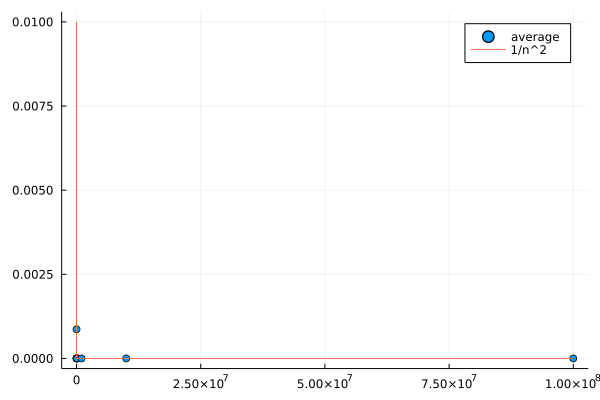

In [3]:
function average_err(u, c, f, n)
    x = range(0,1; length = n)
    h = step(x)
    L = Bidiagonal([1; fill(1/h, n-1)], fill(-1/h, n-1), :L)
    u_a = L \ [c; (f.(x[1:end-1]) + f.(x[2:end]))/2]
    norm(u_a - u.(x), Inf)
end

c = 0 # u(0) = 0
f = x -> cos(x)
ns = 10 .^ (1:8) # solve up to n = 10 million

scatter(ns, average_err.(sin, 0, f, ns); label="average")
plot!(ns, ns .^ (-2); label="1/n^2")

### Forward Euler
Now consider a scalar linear time-evolution problem for $0 ≤ t ≤ T$:
$$
\begin{align*}
u(0 ) &= c \\
u'(t) &= f(t) + a(t) u(t)
\end{align*}
$$
Label the $n$-point grid as $t_k = (k-1)h$ for $h = T/(n-1)$.

We can construct a bidiagonal system through forward substitution:
$$
\begin{align*}
u_1 &= c \\
u_{k+1} &= (1 + h a(t_k)) u_k + h f(t_k)
\end{align*}
$$

### Backward Euler
$$
\begin{align*}
u_1 &= c \\
u_{k+1} &= (1 - h a(t_{k+1}))^{-1} (u_k + h f(t_{k+1}))
\end{align*}
$$

### Systems of equations
We can also solve systems, that is, equations of the form:
$$
\begin{align*}
𝐮(0) &= 𝐜 \\
𝐮'(t) - A(t) 𝐮(t) &= 𝐟(t)
\end{align*}
$$

By **forward euler**: 
$$
\begin{align*}
𝐮_1 &= c \\
𝐮_{k+1} &= 𝐮_k + h A(t_k) 𝐮_k + h 𝐟(t_k) &= (I + h A(t_k)) 𝐮_k + h 𝐟(t_k)
\end{align*}
$$

By **Backward Euler**:
$$
\begin{align*}
𝐮_1 &= c \\
𝐮_{k+1} &= (I- h A(t_{k+1}))^{-1} (𝐮_k  + h 𝐟(t_{k+1}))
\end{align*}
$$


### Example: Airy Equation

$$
\begin{align*}
u(0) &= 1 \\
u'(0) &= 0 \\
u''(t) + t u &= 0
\end{align*}
$$
We can recast it as a system by defining
$$
𝐮(x) = \begin{bmatrix} u(x) \\ u'(x) \end{bmatrix}
$$
which satisfies
$$
\begin{align*}
𝐮(0) = \begin{bmatrix} 1 \\ 0 \end{bmatrix} \\
𝐮' - \begin{bmatrix} 0 & 1 \\ -t & 0 \end{bmatrix} 𝐮 = 𝟎.
\end{align*}
$$

In [3]:
n = 100_000
t = range(0, 50; length = n)

A = t -> [0 1; -t 0]
h = step(t)

U = zeros(2, n) # Preallocate memory
U[:,1] = [1, 0] # Initial condition

# using Forward Euler
for k = 1:n-1
    U[:,k+1] = (I + h*A(t[k])) * U[:,k] # forward euler in system of equations
end

plot(t, U')

In [8]:
# using Backward Euler

n = 500_000
t = range(0,50; length = n)
h = step(t)

A = t-> [0 1; -t 0]

U = zeros(2, n) # Preallocate memory
U[:,1] = [1, 0]

for k = 1:n-1
    U[:,k+1] = (I - h*A(t[k+1])) \ U[:,k]
end

# for small n (such as 50), we can see stable for long time which is inaccurate though.

plot(t, U')

### Example: Heat on the graph

$$
u' = \begin{bmatrix} -1 & 1 \\ 
            1 & -2 & ⋱ \\ 
            & 1 & ⋱ & 1 \\
            && ⋱ & -2 & 1 \\
                &&& 1 & -1
                \end{bmatrix} * u + e_{floow(m/2)}*cos(\omega * t)
$$


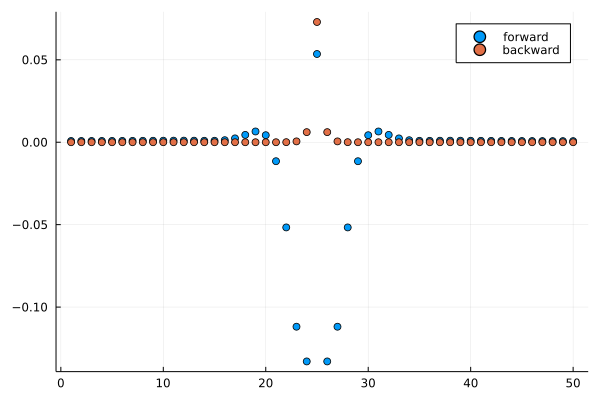

In [14]:
n = 1_000 # number of time-steps
t = range(0, 100; length = n)
h = step(t)

m = 50 # 50 nodes

Δ = SymTridiagonal([-1; fill(-2.0,m-2); -1], fill(1., m-1))

e = zeros(m); e[m÷2] = 1;
ω = 1

# forward Euler
Uᶠ = zeros(m, n)
Uᶠ[:,1] = zeros(m) # initial condition
for k = 1:n-1
    Uᶠ[:,k+1] = (I + h*Δ) * Uᶠ[:,k] + h * e * cos(ω*t[k])
end

# backward Euler
Uᵇ = zeros(m, n)
Uᵇ[:,1] = zeros(m)
for k = n-1
    Uᵇ[:,k+1] = (I - h * Δ) \ (Uᵇ[:,k] + h*cos(t[k+1])*e)
end

scatter(Uᶠ[:,end]; label="forward")
scatter!(Uᵇ[:,end]; label="backward")

### Nonlinear problems

Forward-Euler extends naturally to nonlinear equations, 

$$
𝐮_{k+1} = 𝐮_k + h f(t_k, 𝐮_k)
$$

### Example: Nonlinear Penndulum
Here we show a simple solution to a nonlinear Pendulum:
$$
u'' = -\sin u
$$
by writing $𝐮(t) := [u_1(t),u_2(t)] :=[u(t),u'(t)]$ we have:
$$
𝐮'(t) =  \underbrace{\begin{bmatrix} u_2(t) \\ -\sin u_1(t) \end{bmatrix}}_{f(t, 𝐮(t))}
$$
Again we put the time slices into a $2 × n$ matrix:

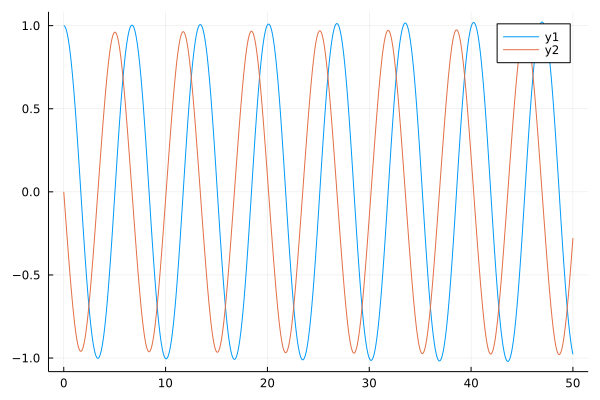

In [33]:
n = 50_000
t = range(0, 50; length = n)
h = step(t)

U = zeros(2, n) # time slices
U[:, 1] = [1,0] # initial condition （change the initial condition will give different shapes completely)

# forward euler
for k = 1:n-1
    U[:,k+1] = U[:,k] + h * [U[2,k], -sin(U[1,k])]
end

plot(t, U')

### Example of using forward/backward Euler method to solve ODEs

Solve the following ODEs 
using forward and/or backward Euler and increasing $n$, the number of time-steps, 
until $u(1)$ is determined to 3 digits:
$$
\begin{align*}
u(0) &= 1, u'(t) = \cos(t) u(t) + t \\
v(0) &= 1, v'(0) = 0, v''(t) = \cos(t) v(t) + t \\
w(0) &= 1, w'(0) = 0, w''(t) = t w(t) + 2 w(t)^2
\end{align*}
$$

In [35]:
function first_eq(n)
    # This function takes n and returns the estimate of u(1) using n steps
    t = range(0,1; length = n)
    h = step(t)

    u = zeros(n) # preallocate memory
    u[1] = 1 # initial condition

    for k = 1:n-1
        u[k+1] = (1 + h*cos(t[k])) * u[k] + h*t[k] # forward euler
    end
    u[end]
end

ns = 2 .^ (1:13)
println(first_eq.(ns)')

# By observation, u(1) is approx 2.96 (to three digits)

[2.0 2.5750568981571456 2.7887231159522656 2.881824999955957 2.9254124926170757 2.9465162316784763 2.9569015164393777 2.962053226375413 2.964618935882748 2.96589926513106 2.966538799730441 2.966858409692436 2.967018175359888]


In [36]:
A = t -> [0 1; cos(t) 0] # Define the matrix

function second_eq(n)
    t = range(0,1; length = n)
    h = step(t)

    u = zeros(2, n) # preallocate memory
    u[:,1] = [1.0, 0.0]

    for k = 1:n-1
        u[:,k+1] = (I + h .* A(t[k])) * u[:,k] + h .* [0, t[k]] # forward euler
    end
    u[1, end]
end

ns = 2 .^ (1:13)
println(second_eq.(ns)')

# By observation, u(1) is approx 1.66

[1.0 1.3642544755164523 1.5225506467348051 1.5962359873789465 1.6318006366873792 1.649274388412367 1.6579354745564159 1.6622472382628792 1.6643984462037793 1.6654728843070914 1.6660098122180145 1.6662782034290025 1.6664123808534863]


In [37]:
function F(t, w)
    [w[2], t*w[1] + 2*w[1]*w[1]] # Notice the second derivative is composed by two w(t)
end

function third_eq(n=1000, c=1.0) # default value, used when no argument is passed
    t = range(0,1; length = n)
    h = step(t)

    w = zeros(2, n) # preallocate memory
    w[:,1] = [c, 0.0]
    
    for k = 1:n-1
        w[:,k+1] = w[:,k] + h .* F(t[k], w[:,k])
    end
    w[1,end]
end

ns = 2 .^ (1:18)
println(third_eq.(ns)')

[1.0 1.7037037037037037 2.1161619507432423 2.405051959928199 2.584234164229442 2.6856795754795195 2.739930778204141 2.7680246576714547 2.7823256423488796 2.789541227463252 2.793165496520641 2.7949817759493967 2.7958909551335647 2.796345805000219 2.796573295053037 2.7966870563658666 2.7967439410945523 2.796772384477209]


### Mid Point Euler (Name given by myself)

For an evenly spaced grid $t_1, …, t_n$, use the approximation
$$
{u'(t_{k+1}) + u'(t_k) \over 2} ≈ {u_{k+1} - u_k \over h}
$$
to recast
$$
\begin{align*}
u(0) &= c \\
u'(t) &= a(t) u(t) + f(t)
\end{align*}
$$
as a lower bidiagonal linear system. 

Solution:
$$
\mathbf{u}_{k+1} = \left(I - \frac{h}{2}A(t_{k+1})\right)^{-1}\left(\left(I + \frac{h}{2}A(t_{k})\right)\mathbf{u}_k + \frac{h}{2}(\mathbf{f}(t_{k+1}) + \mathbf{f}(t_k)) \right),
$$
with initial value,
$$
\mathbf{u}_1 = \mathbf{c}.
$$


### Example of using this method
Implement the method designed above for the negative time Airy equation 
$$
u(0) = 1, u'(0) = 0, u''(t) = -t u(t)
$$
on $[0,50]$.
How many time-steps are needed to get convergence to 1% accuracy (the "eyeball norm")?

**SOLUTION**
We will work with,
$
\mathbf{u}(t) = \left[\begin{matrix}
u(t) \\ u'(t)
\end{matrix} \right],
$
so that our differential equation is:
$$
\mathbf{u}'(t) = \left[\begin{matrix}
u'(t) \\ u''(t)
\end{matrix} \right] =
\left[\begin{matrix}
0 & 1 \\ -t & 0
\end{matrix} \right] \mathbf{u}(t),
$$
so that,
$$
A(t) = \left[\begin{matrix}
0 & 1 \\ -t & 0
\end{matrix} \right],
$$
and with initial conditions,
$$
\mathbf{u}(0) = \left[\begin{matrix}
1 \\ 0
\end{matrix} \right].
$$

We will use the method described in Problem 3.1, with $\mathbf{f}(t) = \mathbf{0}$:

$$
\mathbf{u}_1 = \left[\begin{matrix}
1 \\ 0
\end{matrix} \right], \hspace{5mm}
\mathbf{u}_{k+1} = \left(I - \frac{h}{2}A(t_{k+1})\right)^{-1}\left(I + \frac{h}{2}A(t_{k})\right)\mathbf{u}_k.
$$


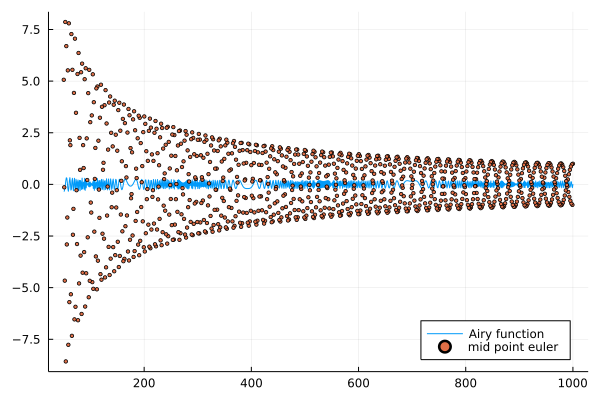

In [40]:
using SpecialFunctions

n = 1000
t = range(n, 50; length = n)
h = step(t)

A = t -> [0 1; -t 0]

U = zeros(2, n)
U[:,1] = [1.0, 0.0]

for k = 1:n-1
    U[:,k+1] = (I - h/2 .* A(t[k+1])) \ ((I + h/2 .* A(t[k])) * U[:,k])
end

# True solution from wolfram alpha
u = t -> real(1/2 * 3^(1/6) * gamma(2/3) * (sqrt(3)airyai((-1 + 0im)^(1/3)*t) + airybi((-1+0im)^(1/3)*t)))

plot(t, u.(t), label="Airy function")
scatter!(t, U[1,:], label="mid point euler", legend=:bottomright, markersize=2) # Notice we draw U[1,:]

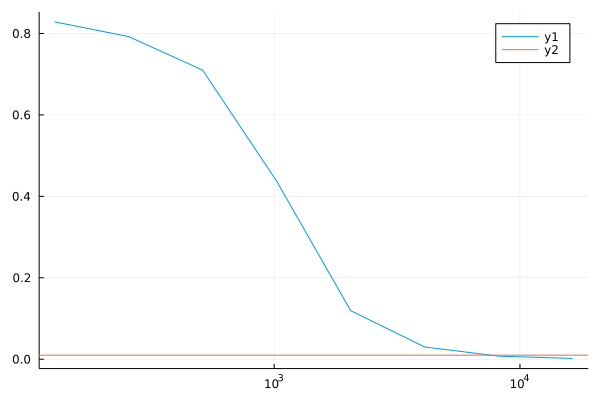

In [42]:
# To find when the error goes below 1%
n = 2 .^ (7:14)
function relative_err(n)
    t = range(0, 50; length = n)
    h = step(t)

    U = zeros(2, n)
    U[:,1] = [1.0, 0.0]
    u = t -> real(1/2 * 3^(1/6) * gamma(2/3) * (sqrt(3)airyai((-1 + 0im)^(1/3)*t) + airybi((-1+0im)^(1/3)*t)))

    for k = 1:n-1
        U[:,k+1] = (I - h/2 .* A(t[k+1])) \ ((I + h/2 .* A(t[k])) * U[:,k])
    end
    norm(U[1,:] - u.(t), Inf) / norm(u.(t), Inf)
end

plot(n, relative_err.(n), xscale=:log10)
plot!([0.01], seriestype=:hline)
        

### Example of comparing above three euler methods
Consider the equation
$$
u(1) = 1, u'(t) = -10u(t)
$$
What behaviour do you observe on $[0,10]$ of forward, backward, and mid-point
with a step-size of 0.5? What happens if you decrease the step-size to $0.01$? (Hint: you may wish to do a plot and scale the $y$-axis logarithmically,)

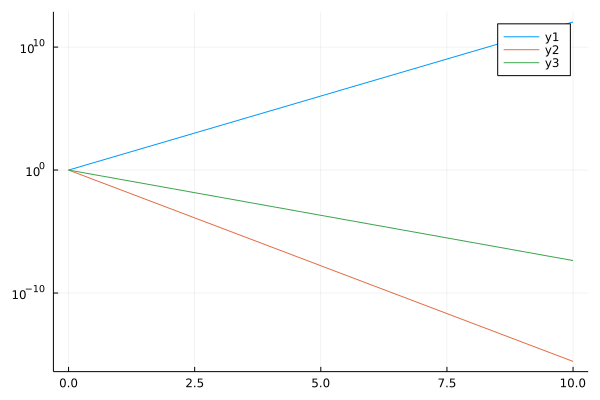

In [49]:
h = 0.5 # We can define our interval first
t = range(0, 10; step = h)
n = length(t) # Then find the total steps

# Define preallocate memory and initial condition for each of the method
uᶠ = zeros(n)
uᵇ = zeros(n)
uᵐ = zeros(n)
uᶠ[1] = uᵇ[1] = uᵐ[1] = 1

# Implementation
a = -10
for k = 1:n-1
    uᶠ[k+1] = (1 + h*a) * uᶠ[k]
    uᵇ[k+1] = (1 - h*a) \ uᵇ[k]
    uᵐ[k+1] = (1 - h/2 * a) \ (1 + h/2 * a) * uᵐ[k]
end

plot(t, abs.(uᶠ); yscale=:log10)
plot!(t, abs.(uᵇ); yscale=:log10)
plot!(t, abs.(uᵗ); yscale=:log10)

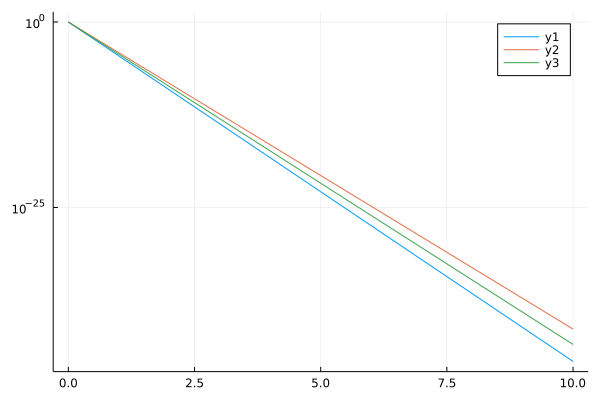

In [53]:
# To decrease the step size to 0.01
h = 0.01
t = range(0, 10; step = h)
n = length(t)

uᶠ = zeros(n)
uᵇ = zeros(n)
uᵐ = zeros(n)
uᶠ[1] = uᵇ[1] = uᵐ[1] = 1

a = -10
for k = 1:n-1
    uᶠ[k+1] = (1 + h*a) * uᶠ[k]
    uᵇ[k+1] = (1 - h*a) \ uᵇ[k]
    uᵐ[k+1] = (1 - h/2 * a) \ (1 + h/2 * a) * uᵐ[k]
end

nanabs(x) = iszero(x) ? NaN : abs(x)

plot(t, nanabs.(uᶠ); yscale=:log10)
plot!(t, nanabs.(uᵇ); yscale=:log10)
plot!(t, nanabs.(uᵐ); yscale=:log10)
    

By inspection, for large h, forward method diverges. But for smaller stepsize, the forward method converges as well.